# Government Employee Salary Analysis Project

In [134]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [135]:
df = pd.read_csv("./YourMoney_Authority_Payroll_20241207.csv")
df.head()

,CALENDAR_YEAR,CALENDAR_QUARTER,AS_OF_DATE,FULL_NAME,AUTHORITY_NAME,SALARY_HOURLY_RATE,MASTER_SECTION_DESC,MASTER_TITLE_DESC,EMPLOYEE_RELATIONS_GROUP,COMPENSATION_METHOD,REGULAR_PAY,OVERTIME_PAYMENTS,ALL_OTHER_PAYMENTS,YTD_EARNINGS,UniqueID
0,2011,4,"DECEMBER 31, 2011","AARON, DANIEL",SOUTH JERSEY PORT CORPORATION,33820.8,Not Provided,GUARDS,Not Provided,FULL TIME,34377.71,4341.43,900.00,39619.14,43CE801A4D65F8AA6ED9CE3D0FBA20F96CB8731D51B1C3...
1,2011,4,"DECEMBER 31, 2011","AARON, GEORGE",SOUTH JERSEY PORT CORPORATION,29598.4,Not Provided,PART TIME GUARDS,Not Provided,PART TIME,341.52,0.00,0.00,341.52,1B239B9BAB21E6A864E000B72B409ECF1EA19BEE1234F7...
2,2011,4,"DECEMBER 31, 2011","ABABIO, ALEXANDER",NEW JERSEY TRANSIT CORPORATION,56576.0,Not Provided,MAINTAINER,BRS,FULL TIME,49612.53,16213.92,9636.28,75462.73,68E163312AEFAC19EA2A0F4C7324065B5F5B388C8C0AB7...
3,2011,4,"DECEMBER 31, 2011","ABABIO, DANIEL",NEW JERSEY TRANSIT CORPORATION,27601.6,Not Provided,CLEANER,ATU-MECH,FULL TIME,25033.86,0.00,2647.84,27681.70,D3521A5E12B22DE458D3868DA583966397CBF71D68E52F...
4,2011,4,"DECEMBER 31, 2011","ABABIO, NANA",NEW JERSEY TRANSIT CORPORATION,52249.6,Not Provided,OPER,ATU-OPER,FULL TIME,45746.34,26691.02,9575.38,82012.74,A47BE2115680200403CFBC31DE60933C7EE307B3FCF9DE...


In [136]:
df.columns

Index(['CALENDAR_YEAR', 'CALENDAR_QUARTER', 'AS_OF_DATE', 'FULL_NAME',
       'AUTHORITY_NAME', 'SALARY_HOURLY_RATE', 'MASTER_SECTION_DESC',
       'MASTER_TITLE_DESC', 'EMPLOYEE_RELATIONS_GROUP', 'COMPENSATION_METHOD',
       'REGULAR_PAY', 'OVERTIME_PAYMENTS', 'ALL_OTHER_PAYMENTS',
       'YTD_EARNINGS', 'UniqueID'],
      dtype='object')

In [137]:
#As of now, 255,591 records
df.shape

(255591, 15)

In [138]:
#Checks how many null values belong to each column
df.isna().sum()

#There seems to be missing for the Employee_Relations_Group column, otherwise, all the data is full.

CALENDAR_YEAR                  0
CALENDAR_QUARTER               0
AS_OF_DATE                     0
FULL_NAME                      0
AUTHORITY_NAME                 0
SALARY_HOURLY_RATE             0
MASTER_SECTION_DESC            0
MASTER_TITLE_DESC              0
EMPLOYEE_RELATIONS_GROUP    1580
COMPENSATION_METHOD            0
REGULAR_PAY                    0
OVERTIME_PAYMENTS              0
ALL_OTHER_PAYMENTS             0
YTD_EARNINGS                   0
UniqueID                       0
dtype: int64

In [139]:
print(df['EMPLOYEE_RELATIONS_GROUP'].nunique())

#Will not be plausible to fill all null values

#So drop rows where it is null
df = df.dropna(subset=['EMPLOYEE_RELATIONS_GROUP'])

#Check if all columns are non null
print(df.isna().sum())

124
CALENDAR_YEAR               0
CALENDAR_QUARTER            0
AS_OF_DATE                  0
FULL_NAME                   0
AUTHORITY_NAME              0
SALARY_HOURLY_RATE          0
MASTER_SECTION_DESC         0
MASTER_TITLE_DESC           0
EMPLOYEE_RELATIONS_GROUP    0
COMPENSATION_METHOD         0
REGULAR_PAY                 0
OVERTIME_PAYMENTS           0
ALL_OTHER_PAYMENTS          0
YTD_EARNINGS                0
UniqueID                    0
dtype: int64


In [140]:
#Lets try and gain some more information from the dataset

#print(df['FULL_NAME'][500:510])

#Finding the most common first names and last names
df['FIRST_NAME'] = df['FULL_NAME'].str.split().str[-1] 
df['LAST_NAME'] = df['FULL_NAME'].str.split().str[0]

top_first_names = df['FIRST_NAME'].value_counts().head(3)
print("Top 3 first names:")
print(top_first_names)

top_last_names = df['LAST_NAME'].value_counts().head(3)
print("\nTop 3 last names :")
print(top_last_names)

top_full_names = df['FULL_NAME'].value_counts().head(3)
print("\nTop 3 full names:")
print(top_full_names)


Top 3 first names:
FIRST_NAME
MICHAEL    6940
JOHN       5749
ROBERT     4902
Name: count, dtype: int64

Top 3 last names :
LAST_NAME
WILLIAMS,    2005
SMITH,       1870
JOHNSON,     1699
Name: count, dtype: int64

Top 3 full names:
FULL_NAME
SMITH, JAMES      68
PEREZ, LUIS       63
BROWN, MICHAEL    60
Name: count, dtype: int64


In [141]:
#Now, let's see if date of joining will determine anything
df['AS_OF_DATE'].nunique()

average_salary_by_date = df.groupby('AS_OF_DATE')['YTD_EARNINGS'].mean().sort_values(ascending=False)

print(average_salary_by_date)

#Seems like the closer the joining date is, the higher the total earnings, with the exception of 2024 and 2016?

AS_OF_DATE
December 31, 2023     77592.324974
December 31, 2022     76543.358825
December 31, 2021     73585.001715
December 31, 2020     72403.292935
December 31, 2019     67751.979263
December 31, 2018     65108.265843
December 31, 2017     63395.053492
December 31, 2015     63166.089690
September 30, 2024    62379.592993
December 31, 2014     59393.795984
December 31, 2016     58564.220539
DECEMBER 31, 2013     57699.282363
DECEMBER 31, 2012     50797.570822
DECEMBER 31, 2011     49832.174317
Name: YTD_EARNINGS, dtype: float64


['FULL TIME' 'PART TIME' 'OTHER' 'SEASONAL' 'HOURLY' 'T' 'Not Provided'
 'RFT' 'INT' 'RPT' 'TPT' 'ACTIVE' 'TERMINATED' 'LEAVE']


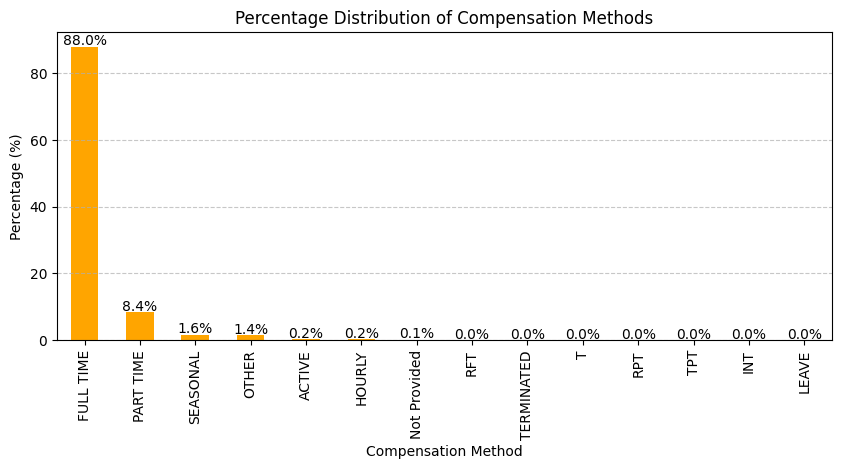

In [142]:
#First, see what types of compensation methods there are.
print(df['COMPENSATION_METHOD'].unique())

#Then, separate all the different types into a chart to see what percentage is 

#Count how much of each compensation method
comp = (df['COMPENSATION_METHOD'].value_counts(normalize=True) * 100).sort_values(ascending=False)

#Plottnig a bar chart (because pie chart was not descriptive enough)
plt.figure(figsize=(10, 4))
comp.plot(kind='bar', color='orange')

plt.title('Percentage Distribution of Compensation Methods')
plt.xlabel('Compensation Method')
plt.ylabel('Percentage (%)')
plt.grid(axis='y', linestyle='--', alpha=0.7)

for index, value in enumerate(comp):
    plt.text(index, value + 0.5, f"{value:.1f}%", ha='center', fontsize=10)

plt.show()

In [143]:
#So it seems that full time employment takes up a vast majority of the data. Part time is nearly 10%
#Seasonal and other take up around 3% in total , and the rest are statistically insignficant

#For the purposes of data visualization and analysis, we'll mainly be looking at full time and part time data

#Create two dataframes, one for full and one for part

full_df = df[df['COMPENSATION_METHOD'] == 'FULL TIME']
part_df = df[df['COMPENSATION_METHOD'] == 'PART TIME']

full_df.head()
part_df.head()

,CALENDAR_YEAR,CALENDAR_QUARTER,AS_OF_DATE,FULL_NAME,AUTHORITY_NAME,SALARY_HOURLY_RATE,MASTER_SECTION_DESC,MASTER_TITLE_DESC,EMPLOYEE_RELATIONS_GROUP,COMPENSATION_METHOD,REGULAR_PAY,OVERTIME_PAYMENTS,ALL_OTHER_PAYMENTS,YTD_EARNINGS,UniqueID,FIRST_NAME,LAST_NAME
1,2011,4,"DECEMBER 31, 2011","AARON, GEORGE",SOUTH JERSEY PORT CORPORATION,29598.40,Not Provided,PART TIME GUARDS,Not Provided,PART TIME,341.52,0.0,0.0,341.52,1B239B9BAB21E6A864E000B72B409ECF1EA19BEE1234F7...,GEORGE,"AARON,"
11,2011,4,"DECEMBER 31, 2011","ABBAS, AGHA",NEW JERSEY TURNPIKE AUTHORITY,12480.00,INTERCHANGE 12,PTTC TPK - 20,LOCAL194PT,PART TIME,2375.70,216.0,217.0,2808.70,91033D26F3AFA3B3778E925C4E32DCD5B28578377CC507...,AGHA,"ABBAS,"
18,2011,4,"DECEMBER 31, 2011","ABBOTT, SHANNA",SOUTH JERSEY TRANSPORTATION AUTHORITY,0.00,STATE POLICE,P/T COMMUNICATION OPERA,196,PART TIME,0.00,0.0,0.0,0.00,769268E3FC9F610D2D3E822862D921B43FC503F61146AE...,SHANNA,"ABBOTT,"
54,2011,4,"DECEMBER 31, 2011","ABRISQUETA, MARIO",NEW JERSEY TRANSIT CORPORATION,15.07,Not Provided,OPER,TWU-OPER,PART TIME,2759.87,0.0,0.0,2759.87,0D639AB58F5ED49E15ED7079B5732908CE7104405A545C...,MARIO,"ABRISQUETA,"
75,2011,4,"DECEMBER 31, 2011","ACEVEDO, BENEDICTO",NEW JERSEY TRANSIT CORPORATION,14.00,Not Provided,PROJ/PROG AIDE P/T,NOT APPLICABLE,PART TIME,9138.50,0.0,413.2,9551.70,E57ED1F2AECEA110A38F8F717727F2B484B58DB8E87F2F...,BENEDICTO,"ACEVEDO,"


All Types - Mean: $59162.56, Median: $59513.48, Mode: $52249.60
Full-Time - Mean: $64701.92, Median: $62067.20, Mode: $52249.60
Part-Time - Mean: $18309.02, Median: $12480.00, Mode: $0.00

This means that there was $46392.90 difference in the mean full time salaries from the mean part time salaries, and 
$5539.37 difference from the mean full time salaries and mean salaries


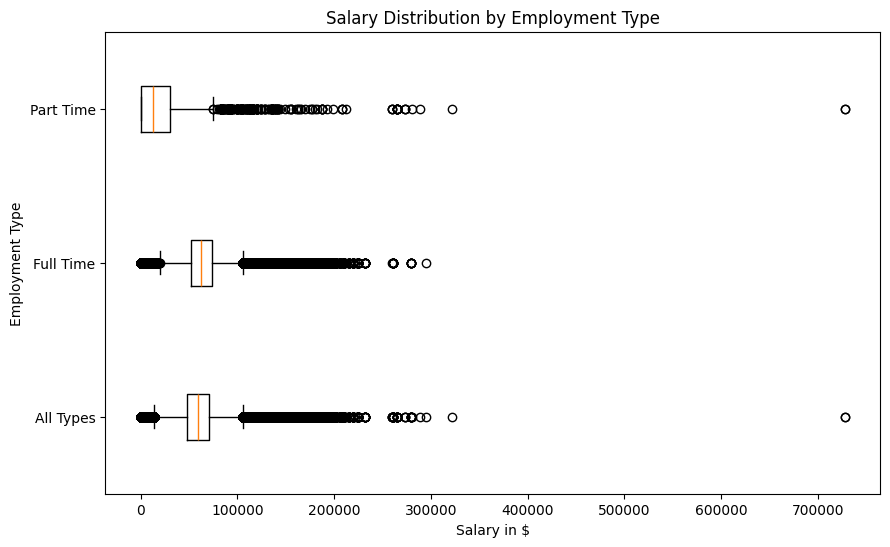

In [144]:
#Statistical salary checking 

#Mean median and mode for all data.
mean_salary_all = df['SALARY_HOURLY_RATE'].mean()
median_salary_all = df['SALARY_HOURLY_RATE'].median()
mode_salary_all = df['SALARY_HOURLY_RATE'].mode()[0]

#Mean median and mode for full time data.
mean_salary_full = full_df['SALARY_HOURLY_RATE'].mean()
median_salary_full = full_df['SALARY_HOURLY_RATE'].median()
mode_salary_full = full_df['SALARY_HOURLY_RATE'].mode()[0]

#Mean median and mode for part time data.
mean_salary_part = part_df['SALARY_HOURLY_RATE'].mean()
median_salary_part = part_df['SALARY_HOURLY_RATE'].median()
mode_salary_part = part_df['SALARY_HOURLY_RATE'].mode()[0]

#Display the results with 2 decimal places for money
print(f"All Types - Mean: ${mean_salary_all:.2f}, Median: ${median_salary_all:.2f}, Mode: ${mode_salary_all:.2f}")
print(f"Full-Time - Mean: ${mean_salary_full:.2f}, Median: ${median_salary_full:.2f}, Mode: ${mode_salary_full:.2f}")
print(f"Part-Time - Mean: ${mean_salary_part:.2f}, Median: ${median_salary_part:.2f}, Mode: ${mode_salary_part:.2f}")

print(f"""\nThis means that there was ${(mean_salary_full-mean_salary_part):.2f} difference in the mean full time salaries from the mean part time salaries, and 
${(mean_salary_full-mean_salary_all):.2f} difference from the mean full time salaries and mean salaries""")

#To put it visually, using a box plot
plt.figure(figsize=(10, 6))

data = [df['SALARY_HOURLY_RATE'], full_df['SALARY_HOURLY_RATE'], part_df['SALARY_HOURLY_RATE']]
plt.boxplot(data, tick_labels=['All Types', 'Full Time', 'Part Time'], vert=False)

plt.xlabel('Salary in $')
plt.ylabel('Employment Type')
plt.title('Salary Distribution by Employment Type')

plt.show()



In [145]:
#Looking at the data, something very interesting is found. There is a significant outlier in the part time data!
#It looks to be more than $700,000, let's see if we can find the specific record.

max_salary = part_df['SALARY_HOURLY_RATE'].max()
print(max_salary)

max_salary_record = part_df.loc[part_df['SALARY_HOURLY_RATE'].idxmax()]
max_salary_record

728000.0


CALENDAR_YEAR                                                            2016
CALENDAR_QUARTER                                                            4
AS_OF_DATE                                                  December 31, 2016
FULL_NAME                                                      CANNITO, PETER
AUTHORITY_NAME                                 NEW JERSEY TRANSIT CORPORATION
SALARY_HOURLY_RATE                                                   728000.0
MASTER_SECTION_DESC                                              Not Provided
MASTER_TITLE_DESC                                          PROJ/PROG AIDE-P/T
EMPLOYEE_RELATIONS_GROUP                                             CORP-ADM
COMPENSATION_METHOD                                                 PART TIME
REGULAR_PAY                                                           19250.0
OVERTIME_PAYMENTS                                                         0.0
ALL_OTHER_PAYMENTS                                              

In [146]:
full_time_max_salary_record = full_df.loc[full_df['SALARY_HOURLY_RATE'].idxmax()]
full_time_max_salary_record

CALENDAR_YEAR                                                            2024
CALENDAR_QUARTER                                                            3
AS_OF_DATE                                                 September 30, 2024
FULL_NAME                                                   SULLIVAN, TIMOTHY
AUTHORITY_NAME                      NEW JERSEY ECONOMIC DEVELOPMENT AUTHORITY
SALARY_HOURLY_RATE                                                   294999.9
MASTER_SECTION_DESC                                                 EXECUTIVE
MASTER_TITLE_DESC                                     CHIEF EXECUTIVE OFFICER
EMPLOYEE_RELATIONS_GROUP                                                  NON
COMPENSATION_METHOD                                                 FULL TIME
REGULAR_PAY                                                          216153.8
OVERTIME_PAYMENTS                                                         0.0
ALL_OTHER_PAYMENTS                                              

In [147]:
#Looking at the records, it seems that the YTD_Earnings of the part time employee with the outlier salary do not match
#When compared to the YTD_Earnings and regular pay difference of the full time employee

#This likely means there was a bug in the database that caused it to misattribute that specific employee

#Let's see how much difference that outlier made to the mean.

print(part_df['SALARY_HOURLY_RATE'].std())
print(f"With the outlier, the salary mean for part time employees was ${mean_salary_part:.2f}")

#Dropping here
part_df.drop(part_df['SALARY_HOURLY_RATE'].idxmax(), inplace=True)

new_mean_salary_part = part_df['SALARY_HOURLY_RATE'].mean()

print(f"Without the outlier, the salary mean for part time employees was ${new_mean_salary_part:.2f}")
print(f"Meaning there was a ${(mean_salary_part - new_mean_salary_part):.2f} difference, which is a lot for {part_df.shape[0]} rows")

print(part_df['SALARY_HOURLY_RATE'].std())

#Additionally, drop the outlier in the full dataframe because of later issues
outlier_index = part_df['SALARY_HOURLY_RATE'].idxmax()

df = df.drop(outlier_index)

24085.765208369914
With the outlier, the salary mean for part time employees was $18309.02
Without the outlier, the salary mean for part time employees was $18275.81
Meaning there was a $33.21 difference, which is a lot for 21370 rows
23591.956547082755


/var/folders/rp/lsntb_3s13xfvtpqdp7760nh0000gn/T/ipykernel_13826/3107510867.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  part_df.drop(part_df['SALARY_HOURLY_RATE'].idxmax(), inplace=True)


Min is 0.0 and max is 294999.9 for full-time employees


/var/folders/rp/lsntb_3s13xfvtpqdp7760nh0000gn/T/ipykernel_13826/3444199668.py:24: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(formatted_labels, rotation=20)


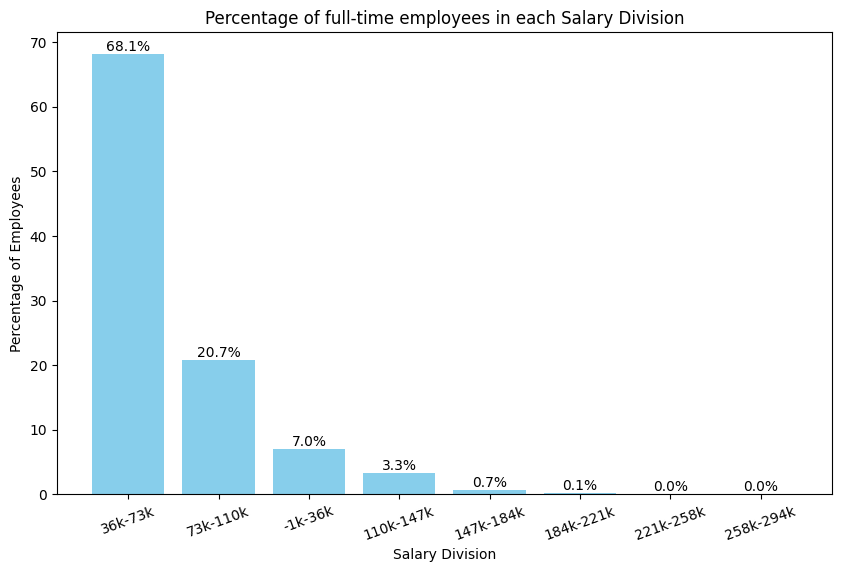

In [148]:
#Going back to the full time employees, let's try and visualize the data in a more coherent way.

min_salary = full_df['SALARY_HOURLY_RATE'].min()
max_salary = full_df['SALARY_HOURLY_RATE'].max()

print(f"Min is {min_salary} and max is {max_salary} for full-time employees")

#Create 8 equal divisions betweenthe min and max salary
salary_bins = np.linspace(min_salary, max_salary, 9) 
full_df['salary_division'] = pd.cut(full_df['SALARY_HOURLY_RATE'], bins=salary_bins, include_lowest=True)

salary_counts = full_df['salary_division'].value_counts()
salary_percentages = salary_counts / len(full_df) * 100

fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(salary_counts.index.astype(str), salary_percentages, color='skyblue')

plt.xlabel('Salary Division')
plt.ylabel('Percentage of Employees')
plt.title('Percentage of full-time employees in each Salary Division')

#Format the x-axis labels so that it fits in form of [num]k in thousands
formatted_labels = [f'{int(interval.left // 1000)}k-{int(interval.right // 1000)}k' for interval in salary_counts.index]
ax.set_xticklabels(formatted_labels, rotation=20)

#Add percentage labels on top of each bar using ax.bar_label
ax.bar_label(bars, labels=[f'{p:.1f}%' for p in salary_percentages])

plt.show()


In [149]:
full_df.columns

Index(['CALENDAR_YEAR', 'CALENDAR_QUARTER', 'AS_OF_DATE', 'FULL_NAME',
       'AUTHORITY_NAME', 'SALARY_HOURLY_RATE', 'MASTER_SECTION_DESC',
       'MASTER_TITLE_DESC', 'EMPLOYEE_RELATIONS_GROUP', 'COMPENSATION_METHOD',
       'REGULAR_PAY', 'OVERTIME_PAYMENTS', 'ALL_OTHER_PAYMENTS',
       'YTD_EARNINGS', 'UniqueID', 'FIRST_NAME', 'LAST_NAME',
       'salary_division'],
      dtype='object')

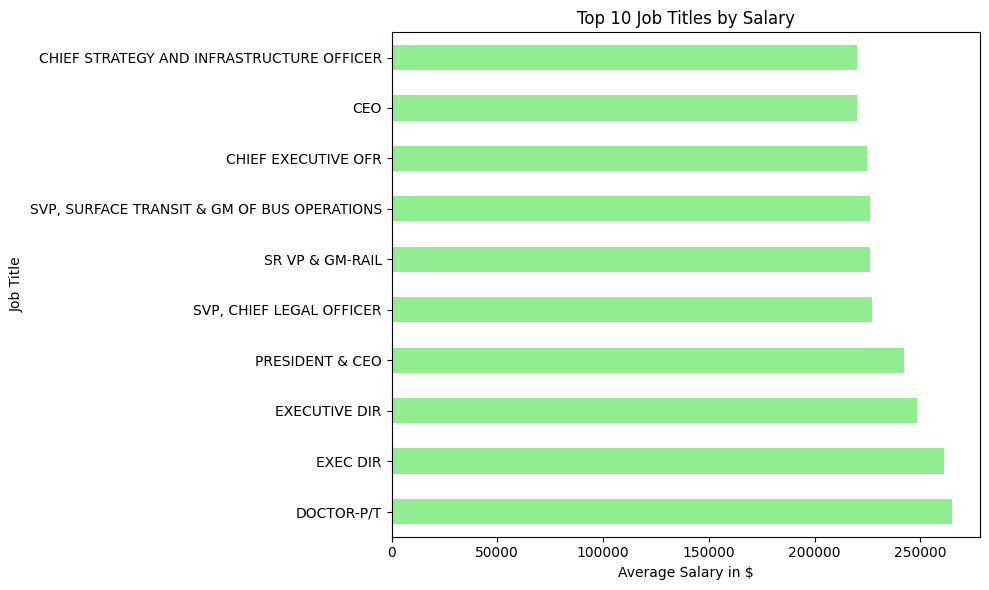

In [150]:
#Lastly, I want to group each category of jobs and find a way to represent them to get a rough idea of salary means

#Grouping by master_title_desc then sorting
avg_salary_by_title = df.groupby('MASTER_TITLE_DESC')['SALARY_HOURLY_RATE'].mean()
avg_salary_by_title = avg_salary_by_title.sort_values(ascending=False)

top_10 = avg_salary_by_title.head(10)

#Horizontal bar chart due to similar values
plt.figure(figsize=(10, 6))
top_10.plot(kind='barh', color='lightgreen')

plt.xlabel('Average Salary in $')
plt.ylabel('Job Title')
plt.title('Top 10 Job Titles by Salary')

plt.tight_layout()
plt.show()



# Machine Learning 

In [151]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.metrics import mean_squared_error, r2_score

#So now, I want to see how accurate I can make the model predict earnings/salary with specific variables

df.columns

Index(['CALENDAR_YEAR', 'CALENDAR_QUARTER', 'AS_OF_DATE', 'FULL_NAME',
       'AUTHORITY_NAME', 'SALARY_HOURLY_RATE', 'MASTER_SECTION_DESC',
       'MASTER_TITLE_DESC', 'EMPLOYEE_RELATIONS_GROUP', 'COMPENSATION_METHOD',
       'REGULAR_PAY', 'OVERTIME_PAYMENTS', 'ALL_OTHER_PAYMENTS',
       'YTD_EARNINGS', 'UniqueID', 'FIRST_NAME', 'LAST_NAME'],
      dtype='object')

In [152]:
print(df['AS_OF_DATE'].dtype)


object


In [153]:
#Out of these columns, I believe AS_OF_DATE, AUTHORITY_NAME, MASTER_TITLE_DESC, COMPENSATION_METHOD will be good

#Relevant columns
ml_df = df[['AS_OF_DATE', 'AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD', 'SALARY_HOURLY_RATE']]

#Needed to sample the data so that it compiled in time
ml_df = ml_df.dropna()
ml_df = ml_df.sample(frac=0.1, random_state=10)
ml_df['AS_OF_DATE'] = pd.to_datetime(ml_df['AS_OF_DATE'], format='%B %d, %Y')

ml_df['YEAR'] = ml_df['AS_OF_DATE'].dt.year
ml_df['MONTH'] = ml_df['AS_OF_DATE'].dt.month
ml_df = ml_df.drop(columns=['AS_OF_DATE'])  # Drop 'AS_OF_DATE' after extracting year and month

categorical_cols = ['AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD']
ml_df = pd.get_dummies(ml_df, columns=categorical_cols, drop_first=True)

X = ml_df.drop(columns=['SALARY_HOURLY_RATE'])
y = ml_df['SALARY_HOURLY_RATE']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MSE = {mse:.2f}")
print(f"R2 score = {r2:.2f}")

MSE = 13837991029917139989430272.00
R2 score = -17945271052979728.00


In [154]:
#There seems to be a huge values for the mean squared error and R2 score, meaning there was some sort of problem

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE = {mse:.2f}")
print(f"R2 score = {r2:.2f}")


MSE = 13837991029917139989430272.00
R2 score = -17945271052979728.00


In [155]:
from sklearn.preprocessing import PolynomialFeatures

ml_df = df[['AS_OF_DATE', 'AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD', 'SALARY_HOURLY_RATE']]

ml_df = ml_df.dropna()
ml_df = ml_df.sample(frac=0.005, random_state=42)

ml_df['AS_OF_DATE'] = pd.to_datetime(ml_df['AS_OF_DATE'], format='%B %d, %Y')
ml_df['YEAR'] = ml_df['AS_OF_DATE'].dt.year
ml_df = ml_df.drop(columns=['AS_OF_DATE'])  # Drop 'AS_OF_DATE' after extracting year

categorical_cols = ['AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD']
ml_df = pd.get_dummies(ml_df, columns=categorical_cols, drop_first=True)

X = ml_df.drop(columns=['SALARY_HOURLY_RATE'])
y = ml_df['SALARY_HOURLY_RATE']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

poly = PolynomialFeatures(degree=2, include_bias=False)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_poly)
X_test_scaled = scaler.transform(X_test_poly)

model = LinearRegression()
model.fit(X_train_scaled, y_train)

y_pred = model.predict(X_test_scaled)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MSE = {mse:.2f}")
print(f"R2 score = {r2:.2f}")


MSE = 1206090314887485452176977238991881371648.00
R2 score = -1677970780736732601559417880576.00


In [156]:
ml_df = df[['AS_OF_DATE', 'AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD', 'SALARY_HOURLY_RATE', 'YTD_EARNINGS']]

ml_df = ml_df.dropna()

ml_df = ml_df.sample(frac=0.1)

ml_df['AS_OF_DATE'] = pd.to_datetime(ml_df['AS_OF_DATE'], format='%B %d, %Y')
ml_df['YEAR'] = ml_df['AS_OF_DATE'].dt.year
ml_df['MONTH'] = ml_df['AS_OF_DATE'].dt.month
ml_df = ml_df.drop(columns=['AS_OF_DATE'])  

categorical_cols = ['AUTHORITY_NAME', 'MASTER_TITLE_DESC', 'COMPENSATION_METHOD']
ml_df = pd.get_dummies(ml_df, columns=categorical_cols, drop_first=True)

X = ml_df.drop(columns=['SALARY_HOURLY_RATE'])
y = ml_df['SALARY_HOURLY_RATE']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MSE = {mse:.2f}")
print(f"R2 score = {r2:.2f}")


MSE = 170576319.28
R2 score = 0.77


In [157]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE = {mse:.2f}")
print(f"R2 score = {r2:.2f}")

#much better

MSE = 170576319.28
R2 score = 0.77


# Database creation, connection, and querying

In [158]:
import sqlite3
from sqlalchemy import create_engine, text

#Sql alchemy engine creation
engine = create_engine('sqlite:///government_employees.db')

In [159]:
df.to_sql('govinfo', con=engine, if_exists='replace', index=False)

254010

In [160]:
#Creating the cursor 

conn = sqlite3.connect('government_employees.db')
cursor = conn.cursor()

In [161]:
df.dtypes

CALENDAR_YEAR                 int64
CALENDAR_QUARTER              int64
AS_OF_DATE                   object
FULL_NAME                    object
AUTHORITY_NAME               object
SALARY_HOURLY_RATE          float64
MASTER_SECTION_DESC          object
MASTER_TITLE_DESC            object
EMPLOYEE_RELATIONS_GROUP     object
COMPENSATION_METHOD          object
REGULAR_PAY                 float64
OVERTIME_PAYMENTS           float64
ALL_OTHER_PAYMENTS          float64
YTD_EARNINGS                float64
UniqueID                     object
FIRST_NAME                   object
LAST_NAME                    object
dtype: object

DATABASE SCHEMA:

```
CALENDAR_YEAR                int
CALENDAR_QUARTER             int
AS_OF_DATE                   date
FULL_NAME                    VARCHAR(255)
AUTHORITY_NAME               VARCHAR(255)
SALARY_HOURLY_RATE           float
MASTER_SECTION_DESC          VARCHAR(255)
MASTER_TITLE_DESC            VARCHAR(255)
EMPLOYEE_RELATIONS_GROUP     VARCHAR(255)
COMPENSATION_METHOD          VARCHAR(20)
REGULAR_PAY                  float
OVERTIME_PAYMENTS            float
ALL_OTHER_PAYMENTS           float
YTD_EARNINGS                 float
UniqueID                     CHAR(64)
FIRST_NAME                   VARCHAR(50)
LAST_NAME                    VARCHAR(50)
```

In [162]:
#checking to see what tables are in db

def tables_in_db(conn):
    cur = conn.execute('''SELECT name FROM sqlite_master WHERE type = 'table';''')
    rows = cur.fetchall()

    for row in rows:
        print(row)
tables_in_db(conn)

('govinfo',)


In [163]:
#Testing an example query where I'm using the most common full name
q_example = "SELECT * FROM govinfo WHERE FULL_NAME = 'SMITH, JAMES';"
cursor.execute(q_example)
rows = cursor.fetchall()
for row in rows: 
    print(row)

(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TRANSIT CORPORATION', 54558.4, 'Not Provided', 'CARMAN', 'BRC', 'FULL TIME', 39398.51, 11591.52, 8255.31, 59245.34, 'BB22B778D512E8F4722EAB0A5DC9DFA461B7F8BA58BDDA778FACAFE9C7305F3F', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TRANSIT CORPORATION', 55452.8, 'Not Provided', 'BOILERMAKER', 'IBB', 'FULL TIME', 50327.7, 12886.78, 7499.72, 70714.2, '75EE6414C0A86AF283933B5C78AC8F8511769E8A7F145D3BA265496F225586AC', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TURNPIKE AUTHORITY', 13312.0, 'INTERCHANGE 17', 'PTTC TPK-16', 'LOCAL194PT', 'PART TIME', 13620.65, 1069.85, 600.0, 15290.5, 'B80A3724EFBE9478FEB21653743E983EA1676520D9CE405C8698F0E7E3947074', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TURNPIKE AUTHORITY', 24960.0, 'JANITORS', 'TEMPORARY JANITOR', 'NON UNION', 'SEASONAL', 18912.0, 3249.0, 394.45, 22555.45, '72E688A704549AF1F8E

In [164]:
def run_query(query):
    cursor.execute(query)
    return cursor.fetchall()

def run_query_rows(query):
    cursor.execute(query)
    rows = cursor.fetchall()
    for row in rows: 
        print(row)

run_query_rows(q_example)

(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TRANSIT CORPORATION', 54558.4, 'Not Provided', 'CARMAN', 'BRC', 'FULL TIME', 39398.51, 11591.52, 8255.31, 59245.34, 'BB22B778D512E8F4722EAB0A5DC9DFA461B7F8BA58BDDA778FACAFE9C7305F3F', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TRANSIT CORPORATION', 55452.8, 'Not Provided', 'BOILERMAKER', 'IBB', 'FULL TIME', 50327.7, 12886.78, 7499.72, 70714.2, '75EE6414C0A86AF283933B5C78AC8F8511769E8A7F145D3BA265496F225586AC', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TURNPIKE AUTHORITY', 13312.0, 'INTERCHANGE 17', 'PTTC TPK-16', 'LOCAL194PT', 'PART TIME', 13620.65, 1069.85, 600.0, 15290.5, 'B80A3724EFBE9478FEB21653743E983EA1676520D9CE405C8698F0E7E3947074', 'JAMES', 'SMITH,')
(2011, 4, 'DECEMBER 31, 2011', 'SMITH, JAMES', 'NEW JERSEY TURNPIKE AUTHORITY', 24960.0, 'JANITORS', 'TEMPORARY JANITOR', 'NON UNION', 'SEASONAL', 18912.0, 3249.0, 394.45, 22555.45, '72E688A704549AF1F8E

In [165]:
#Now, to run some queries

salary_list = [10000 * i for i in range(1,15)]

for salary in salary_list:
    salary_q = f"SELECT COUNT(*) FROM govinfo WHERE SALARY_HOURLY_RATE >= {salary}"
    print(f"There are {run_query(salary_q)[0][0]} people with a salary above ${salary}")

print()
run_query_rows('SELECT MAX(OVERTIME_PAYMENTS) FROM govinfo')
run_query_rows('SELECT MIN(OVERTIME_PAYMENTS) FROM govinfo')
print()

overtime_list = [5000 * i for i in range(1,15)]
for overtime in overtime_list:
    overtime_q = f"SELECT COUNT(*) FROM govinfo WHERE OVERTIME_PAYMENTS >= {overtime}"
    print(f"There are {run_query(overtime_q)[0][0]} people with overtime payments above ${overtime}")



There are 237264 people with a salary above $10000
There are 229210 people with a salary above $20000
There are 222503 people with a salary above $30000
There are 207735 people with a salary above $40000
There are 185430 people with a salary above $50000
There are 124169 people with a salary above $60000
There are 72893 people with a salary above $70000
There are 41581 people with a salary above $80000
There are 23779 people with a salary above $90000
There are 15050 people with a salary above $100000
There are 9826 people with a salary above $110000
There are 6148 people with a salary above $120000
There are 3892 people with a salary above $130000
There are 2516 people with a salary above $140000

(214891.38,)
(-1496.01,)

There are 117221 people with overtime payments above $5000
There are 87162 people with overtime payments above $10000
There are 64099 people with overtime payments above $15000
There are 46715 people with overtime payments above $20000
There are 33558 people with ov

In [166]:
# run_query_rows("""SELECT FULL_NAME, SALARY_HOURLY_RATE, MASTER_TITLE_DESC FROM govinfo WHERE
#                SALARY_HOURLY_RATE >= 140000 AND COMPENSATION_METHOD = 'FULL TIME';""")

run_query_rows("""SELECT FULL_NAME, SALARY_HOURLY_RATE, MASTER_TITLE_DESC 
FROM govinfo WHERE
SALARY_HOURLY_RATE >= 140000 AND COMPENSATION_METHOD = 'PART TIME';""")

('ALBRIGHT, KATHERINE', 176800.0, 'PROJ/PROG AIDE P/T')
('COLE, JANET', 260000.0, 'DOCTOR P/T')
('JAYANATHAN, SUBENDRINI', 208000.0, 'DOCTOR P/T')
('DALAL, GITA', 260000.0, 'DOCTOR-P/T')
('JAYANATHAN, SUBENDRINI', 208000.0, 'DOCTOR P/T')
('CANNITO, PETER', 728000.0, 'PROJ/PROG AIDE-P/T')
('DALAL, GITA', 260000.0, 'DOCTOR-P/T')
('JAYANATHAN, SUBENDRINI', 208000.0, 'DOCTOR-P/T')
('PAPAGEORGIS, JOANN', 156000.0, 'PROJ/PROG AIDE-P/T')
('DALAL, GITA', 264950.4, 'DOCTOR-P/T')
('JAYANATHAN, SUBENDRINI', 211952.0, 'DOCTOR-P/T')
('PAPAGEORGIS, JOANN', 156000.0, 'PROJ/PROG AIDE-P/T')
('ROBERTS, RICHARD', 187200.0, 'PROJ/PROG AIDE-P/T')
('DALAL, GITA', 264950.4, 'DOCTOR-P/T')
('FACEN, SANDRA', 142400.16, 'PROJ/PROG AIDE-P/T')
('GIBLIN, KELLY', 162566.17, 'PROJ/PROG AIDE-P/T')
('JAYANATHAN, SUBENDRINI', 264950.4, 'DOCTOR-P/T')
('MARTIN, THOMAS', 141897.6, 'PROJ/PROG AIDE-P/T')
('PAPAGEORGIS, JOANN', 156000.0, 'PROJ/PROG AIDE-P/T')
('ROBERTS, RICHARD', 187200.0, 'PROJ/PROG AIDE-P/T')
('DALAL, GITA'

In [167]:
q = '''SELECT FULL_NAME, AUTHORITY_NAME, ALL_OTHER_PAYMENTS, SALARY_HOURLY_RATE FROM govinfo
WHERE SALARY_HOURLY_RATE > (SELECT AVG(SALARY_HOURLY_RATE) FROM govinfo) AND 
COMPENSATION_METHOD = 'FULL TIME';'''

run_query_rows(q)

('ABBOTT, CHARLES', 'NEW JERSEY TURNPIKE AUTHORITY', 10034.85, 86144.01)
('ABBOUD, MOUSSA', 'NEW JERSEY TRANSIT CORPORATION', 12232.87, 91000.0)
('ABDUL, JOHN P', 'NEW JERSEY SPORTS & EXPOSITION AUTHORITY', 10862.7, 61900.8)
('ABELES, DAVID', 'NEW JERSEY TRANSIT CORPORATION', 13806.06, 81629.08)
('ABERCROMBIE, JACK', 'NEW JERSEY TRANSIT CORPORATION', 11629.5, 61172.8)
('ABOYOUN, LOUIS', 'NEW JERSEY TURNPIKE AUTHORITY', 29729.2, 86144.01)
('ABRAHAM, MATTHEW', 'NEW JERSEY ECONOMIC DEVELOPMENT AUTHORITY', 0.0, 81695.12)
('ABRAHAMS, LINDA', 'NEW JERSEY TRANSIT CORPORATION', 11984.16, 75000.12)
('ABRAMO, JOSEPH', 'NEW JERSEY SPORTS & EXPOSITION AUTHORITY', 0.0, 66883.44)
('ABRANTES, JOAQUIM', 'NEW JERSEY TRANSIT CORPORATION', 14611.0, 65520.0)
('ABUAN, MAYNARD', 'NEW JERSEY TURNPIKE AUTHORITY', 1656.83, 86155.0)
('ABUSI, PATRICK', 'SOUTH JERSEY PORT CORPORATION', 0.0, 102502.4)
('ACCORDINO, JEFFREY', 'NEW JERSEY TRANSIT CORPORATION', 16405.44, 70699.2)
('ACEVEDO, HECTOR', 'NEW JERSEY TURNPI

In [168]:
df.columns

Index(['CALENDAR_YEAR', 'CALENDAR_QUARTER', 'AS_OF_DATE', 'FULL_NAME',
       'AUTHORITY_NAME', 'SALARY_HOURLY_RATE', 'MASTER_SECTION_DESC',
       'MASTER_TITLE_DESC', 'EMPLOYEE_RELATIONS_GROUP', 'COMPENSATION_METHOD',
       'REGULAR_PAY', 'OVERTIME_PAYMENTS', 'ALL_OTHER_PAYMENTS',
       'YTD_EARNINGS', 'UniqueID', 'FIRST_NAME', 'LAST_NAME'],
      dtype='object')

In [169]:
q = '''SELECT AUTHORITY_NAME, FULL_NAME, YTD_EARNINGS
FROM govinfo
WHERE YTD_EARNINGS IS NOT NULL
ORDER BY YTD_EARNINGS DESC
LIMIT 5;'''

run_query_rows(q)

('NEW JERSEY HEALTH CARE FACILITIES FINANCING AUTHORITY', 'FUENTES, EDWIN', 811185.0)
('NEW JERSEY TURNPIKE AUTHORITY', 'CLARKE, CAROLINE', 657423.15)
('NEW JERSEY TRANSIT CORPORATION', 'SHANAHAN, KATHLEEN', 515494.14)
('NEW JERSEY TRANSIT CORPORATION', 'ADDERLEY, OPHELIA', 486086.0)
('NEW JERSEY CASINO REINVESTMENT DEVELOPMENT AUTHORITY', 'DOHERTY, MATTHEW', 437149.94)


In [170]:
q = '''
SELECT CALENDAR_QUARTER, COMPENSATION_METHOD, AVG(SALARY_HOURLY_RATE) AS AVG_SALARY
FROM govinfo
WHERE SALARY_HOURLY_RATE IS NOT NULL
GROUP BY CALENDAR_QUARTER, COMPENSATION_METHOD
ORDER BY CALENDAR_QUARTER, COMPENSATION_METHOD;
'''

run_query_rows(q)

(3, 'ACTIVE', 89235.65956989246)
(3, 'FULL TIME', 78107.51017088015)
(3, 'HOURLY', 45990.69766233767)
(3, 'Not Provided', 20762.98025210084)
(3, 'OTHER', 12937.773333333333)
(3, 'PART TIME', 32525.100609358)
(3, 'SEASONAL', 34536.86363636364)
(3, 'TERMINATED', 77716.56)
(4, 'ACTIVE', 83349.9654054054)
(4, 'FULL TIME', 63591.83794483374)
(4, 'HOURLY', 41567.80401826484)
(4, 'INT', 27040.0)
(4, 'LEAVE', 80799.68)
(4, 'Not Provided', 39479.456666666665)
(4, 'OTHER', 194.8959575062902)
(4, 'PART TIME', 17635.498707153685)
(4, 'RFT', 50184.18891304348)
(4, 'RPT', 19576.8)
(4, 'SEASONAL', 22047.36545545797)
(4, 'T', 2836.3636363636365)
(4, 'TERMINATED', 78212.09314285715)
(4, 'TPT', 31200.0)


In [171]:
q = '''
SELECT CALENDAR_YEAR, AUTHORITY_NAME, SUM(YTD_EARNINGS) AS TOTAL_EARNINGS
FROM govinfo
WHERE YTD_EARNINGS IS NOT NULL
GROUP BY CALENDAR_YEAR, AUTHORITY_NAME
ORDER BY AUTHORITY_NAME, CALENDAR_YEAR;
''' 

run_query_rows(q)

(2011, 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 3435004.56)
(2012, 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 3161974.35)
(2011, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 11081835.6)
(2012, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 10434093.59)
(2013, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 10462077.81)
(2014, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 9883526.36)
(2015, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 9456225.75)
(2016, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 18815088.22)
(2017, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 9902977.48)
(2024, 'HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 10715909.35)
(2011, 'NEW JERSEY BUILDING AUTHORITY', 452035.13)
(2012, 'NEW JERSEY BUILDING AUTHORITY', 385649.88)
(2013, 'NEW JERSEY BUILDING AUTHORITY', 391311.63)
(2014, 'NEW JERSEY BUILDING AUTHORITY', 338932.63)
(2015, 'NEW JERSEY BUILDING AUTHORITY', 290304.19)
(2016, 'NEW JERSEY BUILDING AUTHORITY', 259170.15)
(2017, 'NE

In [172]:
q = '''
WITH AvgRegularPay AS(
SELECT AUTHORITY_NAME, AVG(REGULAR_PAY) AS AVG_PAY
FROM govinfo
WHERE REGULAR_PAY IS NOT NULL
GROUP BY AUTHORITY_NAME
)
SELECT g.FULL_NAME, g.AUTHORITY_NAME, g.REGULAR_PAY, a.AVG_PAY
FROM govinfo g
JOIN AvgRegularPay a ON g.AUTHORITY_NAME = a.AUTHORITY_NAME
WHERE g.REGULAR_PAY > 2 * a.AVG_PAY
ORDER BY g.AUTHORITY_NAME, g.REGULAR_PAY DESC;
'''

run_query_rows(q)

('VASSER, JEFFREY S.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 185980.08, 23476.86026923077)
('VASSER, JEFFREY S.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 185980.08, 23476.86026923077)
('MUSICH, GARY M.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 146085.68, 23476.86026923077)
('MUSICH, GARY M.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 146085.68, 23476.86026923077)
('GRIFFIN, JAMES C.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 122440.76, 23476.86026923077)
('GRIFFIN, JAMES C.', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 122440.76, 23476.86026923077)
('KINCAID, ROSALIND', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 118647.88, 23476.86026923077)
('KINCAID, ROSALIND', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 118647.88, 23476.86026923077)
('SIMAN, MAUREEN', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 101848.95, 23476.86026923077)
('SIEG, LARRY L', 'ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 91795.6, 23476.86026923077)
(

In [173]:
q = ''' 
SELECT AUTHORITY_NAME, 
    SUM(OVERTIME_PAYMENTS) * 100.0 / SUM(YTD_EARNINGS) AS OVERTIME_PERCENT
FROM govinfo
WHERE OVERTIME_PAYMENTS IS NOT NULL AND YTD_EARNINGS IS NOT NULL
GROUP BY AUTHORITY_NAME
ORDER BY OVERTIME_PERCENT DESC;
'''

run_query_rows(q)

('NEW JERSEY TRANSIT CORPORATION', 18.72579115830227)
('SOUTH JERSEY PORT CORPORATION', 13.823154921117096)
('UNKNOWN AUTHORITY', 11.982268225756224)
('NEW JERSEY TURNPIKE AUTHORITY', 8.780761134295098)
('NEW JERSEY SPORTS & EXPOSITION AUTHORITY', 5.922915289071702)
('SOUTH JERSEY TRANSPORTATION AUTHORITY', 5.660387909528185)
('NEW JERSEY WATER SUPPLY AUTHORITY', 3.779181398193596)
('HIGHER EDUCATION STUDENT ASSISTANCE AUTHORITY', 1.3586504229507719)
('NEW JERSEY ENVIRONMENTAL INFRASTRUCTURE TRUST', 0.9937826137933989)
('NEW JERSEY CASINO REINVESTMENT DEVELOPMENT AUTHORITY', 0.8623674820537913)
('ATLANTIC CITY CONVENTION & VISITORS AUTHORITY', 0.8506310352900612)
('NEW JERSEY HOUSING & MORTGAGE FINANCING AGENCY', 0.2577385311378867)
('NEW JERSEY ECONOMIC DEVELOPMENT AUTHORITY', 0.05677107161721932)
('NEW JERSEY INFRASTRUCTURE BANK', 0.0389727325924222)
('NEW JERSEY SCHOOLS DEVELOPMENT AUTHORITY', 0.024012199356395637)
('NEW JERSEY REDEVELOPMENT AUTHORITY', 0.0)
('NEW JERSEY HEALTH CARE

In [174]:
q = '''
SELECT FULL_NAME, SALARY_HOURLY_RATE, YTD_EARNINGS, 
       (YTD_EARNINGS / (SALARY_HOURLY_RATE * 2080)) AS EARNING_TO_HOURLY_RATIO
FROM govinfo
WHERE SALARY_HOURLY_RATE IS NOT NULL AND YTD_EARNINGS IS NOT NULL
  AND (YTD_EARNINGS / (SALARY_HOURLY_RATE * 2080)) NOT BETWEEN 0.9 AND 1.1
ORDER BY EARNING_TO_HOURLY_RATIO DESC;
'''

run_query_rows(q)

('DONATO, STEPHEN', 23.5, 100063.3, 2.0471215220949266)
('WRIGHT, LEON', 20.32, 80975.93, 1.9158826563446396)
('DACORTE, PETER', 23.5, 80126.0, 1.639238952536825)
('VUKUSICH, JOSEPH E', 20.32, 68382.92, 1.6179332601453664)
('VILLANI, JAMES', 22.19, 72693.64, 1.574982667175096)
('VILLANI, JAMES', 22.19, 64118.89, 1.389201866745242)
('ZELESKI, THOMAS', 22.19, 62371.85, 1.3513504437203174)
('GOMEZ, NEMESIO', 20.32, 55282.59, 1.307980721910963)
('BERTAN, MICHAEL', 23.5, 63081.21, 1.2905321194762684)
('GOMEZ, DAVID S', 20.32, 53927.58, 1.2759213166262873)
('PRONGAY, JOHN W', 21.35, 55615.8, 1.2523824536119619)
('WOHL, KAREN', 49.94, 125832.95, 1.211385874587967)
('MARRAZZO, BRANDON F', 21.7, 53956.95, 1.1954304767812831)
('FELTUS, JUDY L', 22.19, 55060.28, 1.1929377404929453)
('ESSMANN, BRETT', 36.02, 86095.33, 1.1491389665997522)
('HICKMAN III, WILLIAM', 25.12, 60026.57, 1.1488426705658992)
('MOSLEY, EDWARD C', 20.32, 48448.78, 1.1462934395820714)
('LUCCIOLA, ROCCO', 20.32, 48237.54, 1.141

In [175]:
conn.close()